# **CDS Project: Part 2**

*Institute of Software Security (E22)*  
*Hamburg University of Technology*  
*SoSe 2023*

## Learning objectives
---

- Identify and extract vulnerable code from software reposiroties
- Identify and extract non-vulnerabile code from software reposiroties.
- Select and apply pre-proceesing techniques.
- Create a dataset of security vulnerabilities.

## Materials
---

- Lecture Slides 3, 5 and 6.
- PyTorch Documentation: [Datasets and Data Loaders](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html) 
- [ProjectKB GitHub repo](https://github.com/SAP/project-kb).
- PyDriller Documentation: [PyDriller](https://pydriller.readthedocs.io/en/latest/)

## Project Description
---

In this project, you will create your own dataset of security vulnerabilities. This dataset should be generated using the information contained in ProjectKB. ProjectKB is a repository created to enable the creation, management and aggregation of a distributed and collaborative knowledge base of vulnerabilities affecting open-source software written in Java programming language. This repository contains a list of CVEs and the corresponding commits that fix it. Usually the vulnerabilities are contained in a method. Your task is to use this repository to extract the vulnerable and fixed version of the methods.

### *Task 1*

- Download the ProjectKB repository (i.e., create a local copy by cloning it).
- Locate the folder containing the CVEs and their corresponding fixing commits.

#### Task 1 Sol:
The data is saved in csv: data_students/vulas_db_msr2019_release.csv

Data structure:
```(vulnerability id, repository url, commit id, class)```

### *Task 2*

- Write a script that extracts (i) the repository URLs and (ii) corresponding fixing commit ID (hash) contained on each CVE.

In [1]:
from yaml import load, dump
try:
    from yaml import CLoader as Loader, CDumper as Dumper
except ImportError:
    from yaml import Loader, Dumper
from pathlib import Path

root_directory = Path('data_students/project-kb-vulnerability-data/statements/')

# Get all files in any folder inside root_directory
yaml_files = root_directory.glob('**/*.yaml')

# TODO: From ProjectKB extract the commit IDs of the fixing commits  
# TODO: Extract the URLs of the repositories that contain the fix for different CVEs
url_commit_dict = {}

for file_path in yaml_files:
    # Perform operations on each YAML file
    with open(file_path, 'r', encoding='utf-8') as file:
        # Read the YAML content
        yaml_content = load(file, Loader=Loader)
        try:
            fixes = yaml_content['fixes']
            for fixesId in fixes:
                for commitID in fixesId['commits']:
                    url_commit_dict[commitID['id']] = commitID['repository']
        except KeyError:
            continue

In [5]:
print(url_commit_dict)
print(len(url_commit_dict))

{'c9cd1e521673ef0cccb8795b78d3cbaefb8a576a': 'https://github.com/igniterealtime/Openfire', '04fcefa44bae1263c7cad6986a9dafed67f0164': 'https://github.com/apache/struts', 'ff8b655c4b04cae41e5ad00df0a7482333e7a25': 'https://github.com/apache/struts', '09147ffad2b3046ed21af0f524c5088e2ac551e': 'https://github.com/apache/struts', 'bd3f2f59c9b09f70aed3ebab6bb69b464ee2d6c': 'https://github.com/apache/struts', 'dae026a0f0511f83852053bae9d5a622e7f8048': 'https://github.com/apache/struts', 'dbc620f84ffb626c6e6738afe0578d617a2b3d3': 'https://github.com/apache/struts', '93866341ec5396d07b5829be55110ff09dc81bc': 'https://github.com/apache/struts', '787352': 'http://svn.apache.org/repos/asf/xerces/java', '2895197d0dad246757d8d1d9eea181cbf0543ae9': 'https://git-wip-us.apache.org/repos/asf/activemq.git', '9dc43f3ffe85c9c56faee235a21f23bfceb865c8': 'https://git-wip-us.apache.org/repos/asf/activemq.git', 'fed39c3619825bd92990cf1aa7a4e85119e00a6e': 'https://git-wip-us.apache.org/repos/asf/activemq.git',

### *Task 3*

- Using the URL, identify and extract the method where the "fix" is introduced. 
- Locate the previous version of the file and extract the same function (i.e., the "vulnerable" version of the same function). 

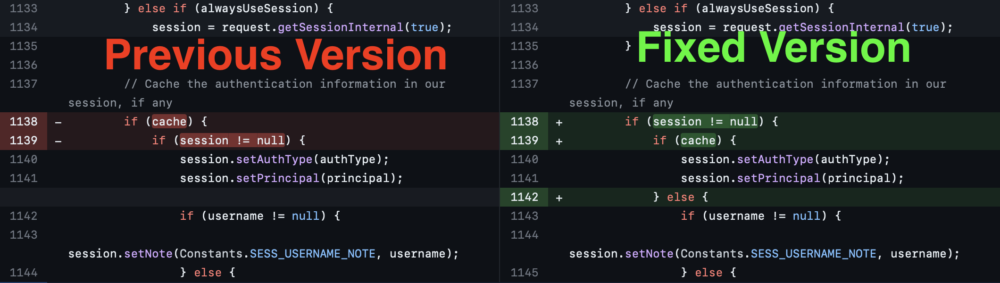

In [6]:
import os

# Specify the full path to the git executable
os.environ['GIT_PYTHON_GIT_EXECUTABLE'] = 'C:\\Program Files\\Git\\bin\\git.exe'

from pydriller import Repository
testCommit = list(url_commit_dict.keys())[2]
print(testCommit)
print(url_commit_dict[testCommit])

# TODO: Extract the method where the fix is introduced

# TODO: Extract the vulnerable version of the same method from the previous version of the file.

ff8b655c4b04cae41e5ad00df0a7482333e7a25
https://github.com/apache/struts


In [7]:
# import os

# # Specify the full path to the git executable
# os.environ['GIT_PYTHON_GIT_EXECUTABLE'] = 'C:\\Program Files\\Git\\bin\\git.exe'

import csv
from pydriller import Repository

def extract_code_changes(url_commit_dict, output_csv):
    total_commits = len(url_commit_dict)
    processed_commits = 0

    with open(output_csv, "w", encoding="UTF8", newline="") as f:
        writer = csv.writer(f, delimiter=',')
        writer.writerow(["method_name", "code", "is_vulnerable"])
        
        for commit_id, repo_url in url_commit_dict.items():
            retry = True
            while (retry):
                try:
                    retry = False
                    for commit in Repository(repo_url, single=commit_id, num_workers=10, clone_repo_to="D:\\Py").traverse_commits():
                        for modified_file in commit.modified_files:
                            if modified_file is None or modified_file.source_code is None or modified_file.source_code_before is None: continue
                            old_source_code = modified_file.source_code_before.split('\n')
                            new_source_code = modified_file.source_code.split('\n')
                            method_names = list(set([method.name for method in modified_file.changed_methods]))

                            for changed_method in method_names:
                                if 'test' in changed_method.lower():
                                    continue
                                try:
                                    old_method = next((method for method in modified_file.methods_before if method.name == changed_method), None)
                                    new_method = next((method for method in modified_file.methods if method.name == changed_method), None)
                                except:
                                    continue

                                old_method_code = ""
                                for i in range(old_method.start_line - 1, old_method.end_line): # -1 is to take the method name also.
                                    old_method_code += old_source_code[i]
                                    print(old_source_code[i])
                                print("--------------------")

                                new_method_code = ""
                                for i in range(new_method.start_line - 1, new_method.end_line):
                                    new_method_code += new_source_code[i]
                                    print(new_source_code[i])
                                print("--------------------")

                                if old_method_code == new_method_code:
                                    continue
                                print(old_method_code)
                                print(new_method_code)
                                writer.writerow([changed_method, old_method_code, 0]) # method name, code, 1 - because it is changed so, vuln
                                writer.writerow([changed_method, new_method_code, 1])
                except Exception as e:
                    print(f"Error processing commit {commit_id}: {e}")
                finally:
                    if not retry:
                        processed_commits += 1
                        print(f"{processed_commits}/{total_commits} commits processed")
                # break

if __name__ == "__main__":
    output_csv = "./code_csv_v2.csv"
    extract_code_changes(url_commit_dict, output_csv)


Error processing commit c9cd1e521673ef0cccb8795b78d3cbaefb8a576a: SHA b'c9cd1e521673ef0cccb8795b78d3cbaefb8a576a' could not be resolved, git returned: b'c9cd1e521673ef0cccb8795b78d3cbaefb8a576a missing'
1/1782 commits processed
Error processing commit 04fcefa44bae1263c7cad6986a9dafed67f0164: 'NoneType' object has no attribute 'start_line'
2/1782 commits processed
Error processing commit ff8b655c4b04cae41e5ad00df0a7482333e7a25: 'NoneType' object has no attribute 'start_line'
3/1782 commits processed
    public static String buildUrl(String action, HttpServletRequest request, HttpServletResponse response, Map params) {
        return buildUrl(action, request, response, params, null, true, true);
    }
--------------------
    public static String buildUrl(String action, HttpServletRequest request, HttpServletResponse response, Map params) {
        return buildUrl(action, request, response, params, null, true, true);
    }
--------------------
4/1782 commits processed
    public static S

Exception ignored in: <function Popen.__del__ at 0x000001FE699ACB80>
Traceback (most recent call last):
  File "c:\Python312\Lib\subprocess.py", line 1130, in __del__
    self._internal_poll(_deadstate=_maxsize)
  File "c:\Python312\Lib\subprocess.py", line 1575, in _internal_poll
    if _WaitForSingleObject(self._handle, 0) == _WAIT_OBJECT_0:
       ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
OSError: [WinError 6] The handle is invalid


    public DomDriver() {
        this(null);
    }
--------------------
    public DomDriver() {
        this(null);
    }
--------------------
417/1782 commits processed
    public HierarchicalStreamReader createReader(final Reader text) {
        try {
            final SAXReader reader = new SAXReader();
            final Document document = reader.read(text);
            return new Dom4JReader(document, getNameCoder());
        } catch (final DocumentException e) {
            throw new StreamException(e);
        }
    }
--------------------
    public HierarchicalStreamReader createReader(final Reader text) {
        try {
            final Document document = createReader().read(text);
            return new Dom4JReader(document, getNameCoder());
        } catch (final DocumentException e) {
            throw new StreamException(e);
        }
    }
--------------------
    public HierarchicalStreamReader createReader(final Reader text) {        try {            final SAXReader r

In [ ]:
import pandas as pd

df = pd.read_csv('./code_csv.csv')
df['old_code'] = df['old_code'].str.replace('\n', '')
df['new_code'] = df['new_code'].str.replace('\n', '')
df.to_csv('./reformatted_csv.csv', index = False)


### *Task 4*
-  Create a labeled dataset using the non-vulnerable and  vulnerable functions extracted in **Step 3**.
- Find a suitable file format for the dataset (CSV, JSON, HDF5, etc.).
- The dataset should contain the following structure:
  - function code
  - boolean label: vulnerable / non-vulnerable

In [ ]:
# TODO: Organize the data collected in the previous step into a labeled dataset

# TODO: Save the dataset to a file in a suitable format.
